# Loading libraries

In [95]:
import os
import cv2
import csv
import glob
import pandas as pd
import numpy as np
import random
import itertools
from collections import Counter
from math import ceil
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from random import choice
import matplotlib.patches as patches
import seaborn as sns

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

%matplotlib inline

# dataset loading

thanks to https://www.kaggle.com/reighns/augmentations-data-cleaning-and-bounding-boxes

In [96]:
train = pd.read_csv("global-wheat-detection/train.csv")  
train_original = train.copy()

IMAGE_PATH = "global-wheat-detection/train/"

train['bbox'] = train['bbox'].apply(lambda x: x[1:-1].split(","))
train['x_min'] = train['bbox'].apply(lambda x: x[0]).astype('float32')
train['y_min'] = train['bbox'].apply(lambda x: x[1]).astype('float32')
train['width'] = train['bbox'].apply(lambda x: x[2]).astype('float32')
train['height'] = train['bbox'].apply(lambda x: x[3]).astype('float32')
train = train[['image_id','x_min', 'y_min', 'width', 'height']]
train["x_max"] = train.apply(lambda col: col.x_min + col.width, axis=1)
train["y_max"] = train.apply(lambda col: col.y_min + col.height, axis = 1)
train['image_id'] = train['image_id']+'.jpg'

# lets add area for bounding boxes
train['area'] = (train['x_max'] - train['x_min'])*(train['y_max'] - train['y_min'])

train['delta_x'] = train['x_max']-new_train['x_min']
train['delta_y'] = train['y_max']-new_train['y_min']

In [97]:
train.head(3)

,image_id,x_min,y_min,width,height,x_max,y_max,area,delta_x,delta_y
0,b6ab77fd7.jpg,834.0,222.0,56.0,36.0,890.0,258.0,2016.0,56.0,36.0
1,b6ab77fd7.jpg,226.0,548.0,130.0,58.0,356.0,606.0,7540.0,130.0,58.0
2,b6ab77fd7.jpg,377.0,504.0,74.0,160.0,451.0,664.0,11840.0,74.0,160.0


# Lets try visualize sample images

Text(0.5, 1.0, '5b032a98f.jpg')

Text(0.5, 1.0, 'cea58b404.jpg')

Text(0.5, 1.0, '6a1ad8811.jpg')

Text(0.5, 1.0, 'd688932d4.jpg')

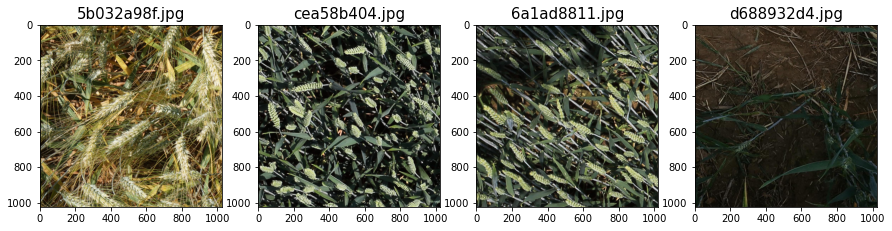

In [98]:
lst_images = train.image_id.unique().tolist()

title_list = [] 
img_matrix_list = []

# 4 random images without bounding boxes
fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(15,5))
for i in range(4):
    rand_img = choice(lst_images)
    ax[i].imshow(cv2.imread(IMAGE_PATH+'\\'+rand_img)[:,:,::-1])
    ax[i].set_title(rand_img, fontsize=15)

    

# Here I will construct bounding boxes area histograms

<Figure size 936x288 with 0 Axes>

(-1000.0, 50000.0)

Text(0.5, 1.0, 'BOUNDING BOXES DISTRIBUTION of AREAS')

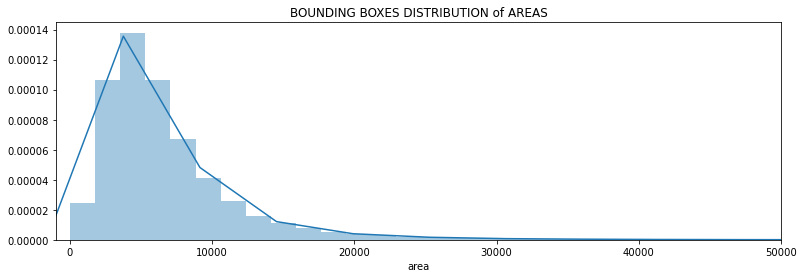

In [99]:
plt.figure(figsize=(13,4))
sns.distplot(train['area'], bins=300)
plt.xlim(-1000,50000)
plt.title('BOUNDING BOXES DISTRIBUTION of AREAS')

In [100]:
np.quantile(train['area'], q=0.998)

43825.79199999984

it is seen that there are bounding boxes with big area. There bounding boxes are amonalies and shouldn't be used for training. <br>LET'S visualize those bounding boxes with images

HERE i WILL VISUALIZE ALL PICTURES WITH BIG AREAS AND FIND BOXES WITH STRANGE VISUAL BEHAVIOUR. 

Text(0.5, 1.0, 'b7c97a57b.jpg')

Text(0.5, 1.0, '2c5b2cd57.jpg')

Text(0.5, 1.0, 'a6fcbeb71.jpg')

Text(0.5, 1.0, '586a28040.jpg')

Text(0.5, 1.0, '037d96952.jpg')

Text(0.5, 1.0, '475d3a571.jpg')

Text(0.5, 1.0, '0a029eead.jpg')

Text(0.5, 1.0, '2c836cccb.jpg')

Text(0.5, 1.0, 'd5943ea17.jpg')

Text(0.5, 1.0, 'dcafcae79.jpg')

Text(0.5, 1.0, '1e58125ec.jpg')

Text(0.5, 1.0, 'c3a8a41cd.jpg')

Text(0.5, 1.0, 'a1321ca95.jpg')

Text(0.5, 1.0, 'b2efe29e7.jpg')

Text(0.5, 1.0, '5e0a7fb4d.jpg')

Text(0.5, 1.0, 'd136f8db2.jpg')

Text(0.5, 1.0, 'ee49343d5.jpg')

Text(0.5, 1.0, '890182186.jpg')

Text(0.5, 1.0, '2bd2f0714.jpg')

Text(0.5, 1.0, '0d3bd5eac.jpg')

c:\python\kaggle\global_wheat_detection\global_wheat_detection\env\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


Text(0.5, 1.0, '2d1b6ce2a.jpg')

Text(0.5, 1.0, 'fec6edf64.jpg')

Text(0.5, 1.0, 'ad6e9eea2.jpg')

Text(0.5, 1.0, '0435654cd.jpg')

Text(0.5, 1.0, 'e596e6bb2.jpg')

Text(0.5, 1.0, 'f1d20d58a.jpg')

Text(0.5, 1.0, 'c164bb5bb.jpg')

Text(0.5, 1.0, 'd4c3b28f4.jpg')

Text(0.5, 1.0, 'f1a8585e0.jpg')

Text(0.5, 1.0, '7257fdd84.jpg')

Text(0.5, 1.0, '94f80c57a.jpg')

Text(0.5, 1.0, 'dded96348.jpg')

Text(0.5, 1.0, '70d39ea64.jpg')

Text(0.5, 1.0, 'e9491d2d6.jpg')

Text(0.5, 1.0, '372d12c55.jpg')

Text(0.5, 1.0, '3cf295f6c.jpg')

Text(0.5, 1.0, '61a658026.jpg')

Text(0.5, 1.0, '43b921912.jpg')

Text(0.5, 1.0, '773bf9022.jpg')

Text(0.5, 1.0, '7e75b3e43.jpg')

Text(0.5, 1.0, 'f8f466cc9.jpg')

Text(0.5, 1.0, '0cbcaf240.jpg')

Text(0.5, 1.0, 'd462add58.jpg')

Text(0.5, 1.0, '9adbfe503.jpg')

Text(0.5, 1.0, 'a3bc2d2ec.jpg')

Text(0.5, 1.0, 'e11b95f4e.jpg')

Text(0.5, 1.0, '2e0c19135.jpg')

Text(0.5, 1.0, '6efc51980.jpg')

Text(0.5, 1.0, 'a57808743.jpg')

Text(0.5, 1.0, '3a4672486.jpg')

Text(0.5, 1.0, '9764d9f54.jpg')

Text(0.5, 1.0, '33d37a437.jpg')

Text(0.5, 1.0, '42e247347.jpg')

Text(0.5, 1.0, '463a95dac.jpg')

Text(0.5, 1.0, 'e1427550f.jpg')

Text(0.5, 1.0, 'd5b96f991.jpg')

Text(0.5, 1.0, 'a06a8b39f.jpg')

Text(0.5, 1.0, 'f4c7f63e6.jpg')

Text(0.5, 1.0, '8f3e2b4e8.jpg')

Text(0.5, 1.0, '635f4a7ae.jpg')

Text(0.5, 1.0, 'c4f8e6485.jpg')

Text(0.5, 1.0, 'c8c449bf0.jpg')

Text(0.5, 1.0, 'eaf18c504.jpg')

Text(0.5, 1.0, 'bfbe6654b.jpg')

Text(0.5, 1.0, '91c9c8b5e.jpg')

Text(0.5, 1.0, '893938464.jpg')

Text(0.5, 1.0, 'fda86ae9a.jpg')

Text(0.5, 1.0, 'cff6e4b78.jpg')

Text(0.5, 1.0, '0a3ff84a7.jpg')

Text(0.5, 1.0, '6df093d5e.jpg')

Text(0.5, 1.0, '22eabfde5.jpg')

Text(0.5, 1.0, 'f85244c49.jpg')

Text(0.5, 1.0, '65d6480b2.jpg')

Text(0.5, 1.0, '93224e554.jpg')

Text(0.5, 1.0, 'c1577d6ff.jpg')

Text(0.5, 1.0, '2fc7b5c3a.jpg')

Text(0.5, 1.0, 'ae1ec9804.jpg')

Text(0.5, 1.0, '71bd00b15.jpg')

Text(0.5, 1.0, 'b824c0e55.jpg')

Text(0.5, 1.0, 'b77e8c906.jpg')

Text(0.5, 1.0, '9a30dd802.jpg')

Text(0.5, 1.0, 'd4d1c9bc4.jpg')

Text(0.5, 1.0, '66d91891d.jpg')

Text(0.5, 1.0, '93648317d.jpg')

Text(0.5, 1.0, 'a44424f39.jpg')

Text(0.5, 1.0, '45a13cbcd.jpg')

Text(0.5, 1.0, '04a47965e.jpg')

Text(0.5, 1.0, '156282051.jpg')

Text(0.5, 1.0, '51f2e0a05.jpg')

Text(0.5, 1.0, '68fedffd4.jpg')

Text(0.5, 1.0, '4be2817ef.jpg')

Text(0.5, 1.0, 'e0a241bd5.jpg')

Text(0.5, 1.0, 'a4b64deca.jpg')

Text(0.5, 1.0, '36d1cc44b.jpg')

Text(0.5, 1.0, 'b82f4b1cb.jpg')

Text(0.5, 1.0, '26263f228.jpg')

Text(0.5, 1.0, 'c3c03e0b7.jpg')

Text(0.5, 1.0, 'a85f39e3d.jpg')

Text(0.5, 1.0, 'd8cae4d1b.jpg')

Text(0.5, 1.0, '5ccb447e6.jpg')

Text(0.5, 1.0, 'd60e832a5.jpg')

Text(0.5, 1.0, 'd067ac2b1.jpg')

Text(0.5, 1.0, '7fc9fe138.jpg')

Text(0.5, 1.0, 'b8ddb6c73.jpg')

Text(0.5, 1.0, '69fc3d3ff.jpg')

Text(0.5, 1.0, '41c0123cc.jpg')

Text(0.5, 1.0, 'd7a02151d.jpg')

Text(0.5, 1.0, '409a8490c.jpg')

Text(0.5, 1.0, '2cc75e9f5.jpg')

Text(0.5, 1.0, '42e6efaaa.jpg')

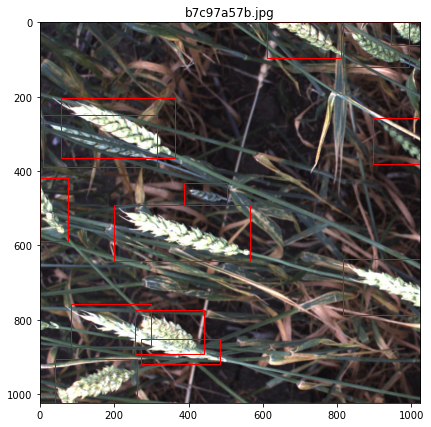

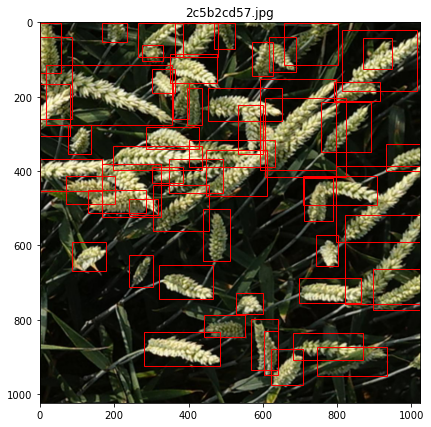

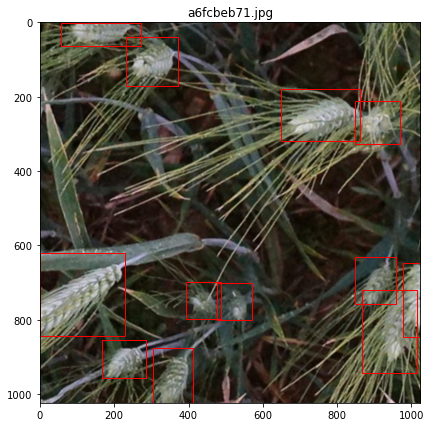

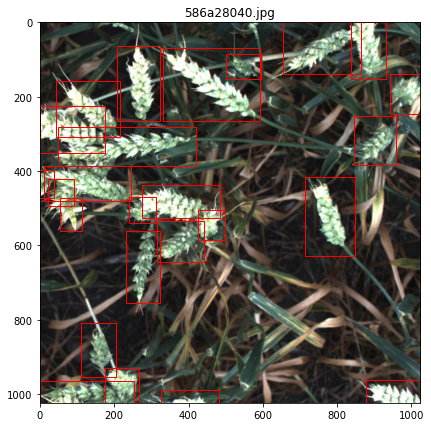

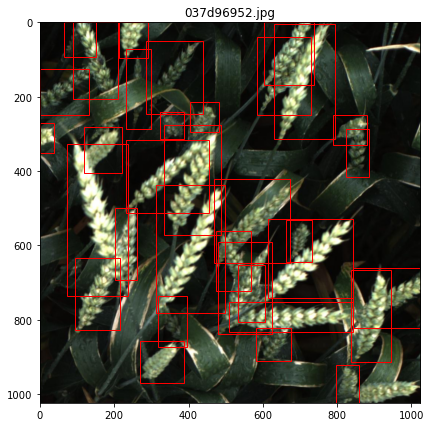

...

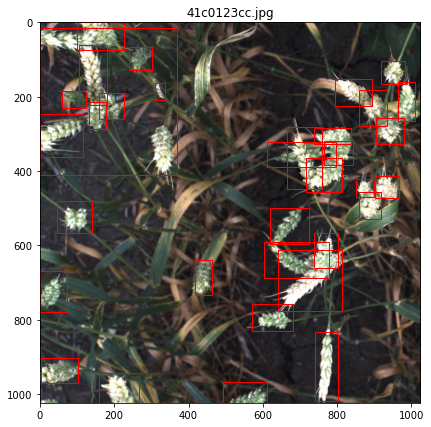

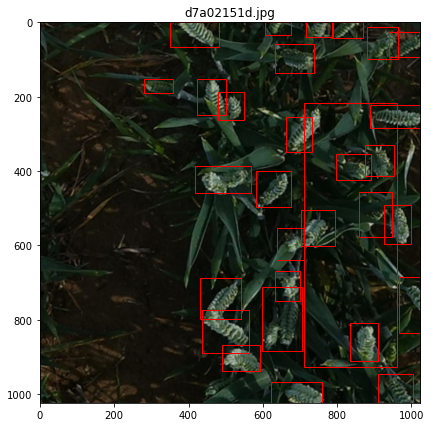

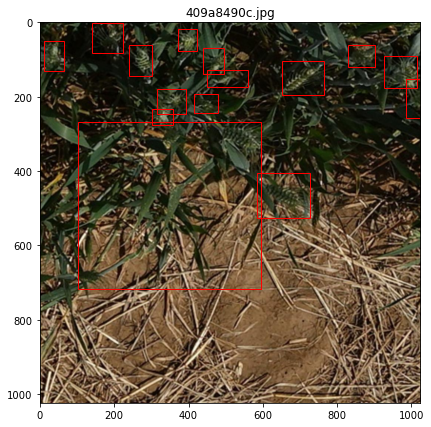

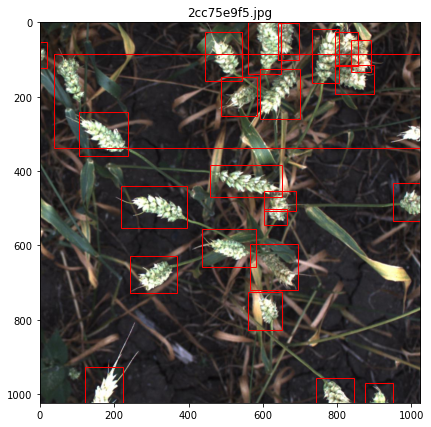

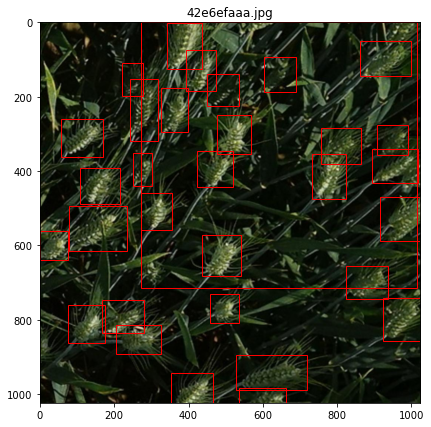

In [101]:
import matplotlib.patches as patches

lst_big_ares = train[train['area']>=50000].sort_values(by='area', ascending=True).image_id.unique().tolist()

for image in tqdm(lst_big_ares):
    
    image_boxes = train[train['image_id']==image]
        
    fig, ax = plt.subplots(1, figsize=(7,7))
    ax.imshow( plt.imread(IMAGE_PATH+'\\'+image) )
    ax.set_title(image)
    for i, row in (image_boxes.iterrows()):
        x_min = int(row['x_min'])
        y_min = int(row['y_min'])
        width = int(row['width'])
        height = int(row['height'])
        # Create a Rectangle patch
        rect = patches.Rectangle((x_min,y_min),width,height,linewidth=1,edgecolor='r', facecolor='none')
        # Add the patch to the Axes
        ax.add_patch(rect)
        

Text(0.5, 1.0, 'd067ac2b1.jpg')

Text(0.5, 1.0, 'd7a02151d.jpg')

Text(0.5, 1.0, '409a8490c.jpg')

Text(0.5, 1.0, '2cc75e9f5.jpg')

Text(0.5, 1.0, '42e6efaaa.jpg')

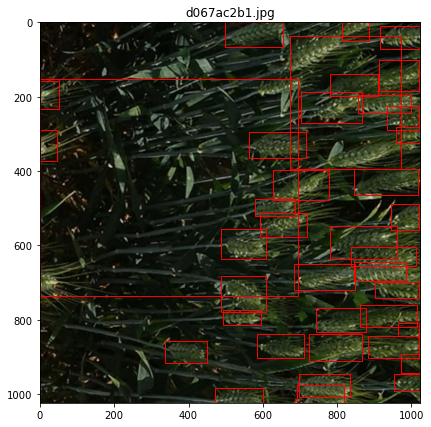

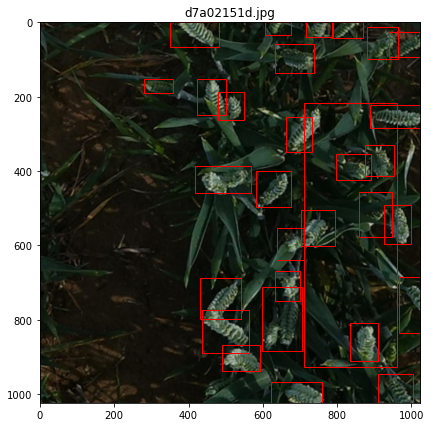

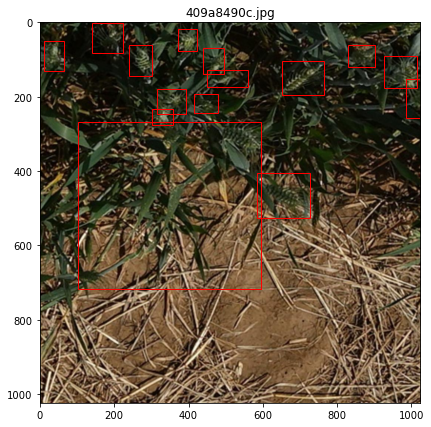

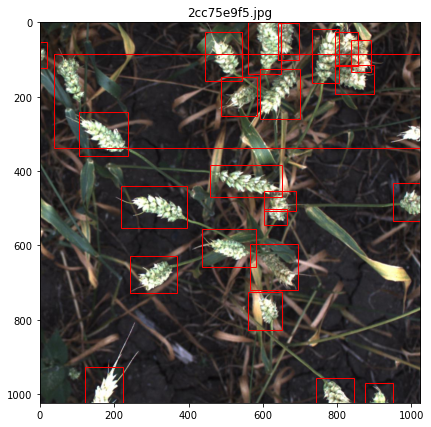

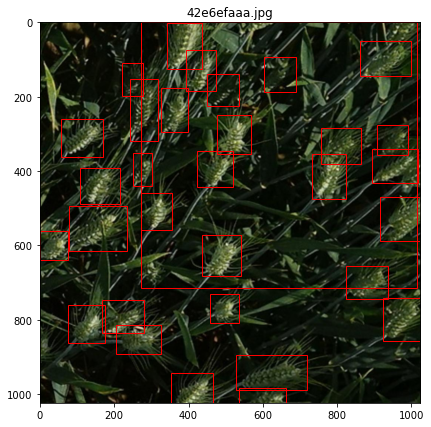

In [102]:
# I have manually looked through the images and here is the list of images with presence of strance bounding boxes.

lst_strange_images = ['d067ac2b1.jpg', 'd7a02151d.jpg', '409a8490c.jpg', '2cc75e9f5.jpg', '42e6efaaa.jpg']

# add lets visualize those images wwith rectangels
for image in tqdm(lst_strange_images):
    
    image_boxes = train[train['image_id']==image]
        
    fig, ax = plt.subplots(1, figsize=(7,7))
    ax.imshow( plt.imread(IMAGE_PATH+'\\'+image) )
    ax.set_title(image)
    for i, row in (image_boxes.iterrows()):
        x_min = int(row['x_min'])
        y_min = int(row['y_min'])
        width = int(row['width'])
        height = int(row['height'])
        # Create a Rectangle patch
        rect = patches.Rectangle((x_min,y_min),width,height,linewidth=1,edgecolor='r', facecolor='none')
        # Add the patch to the Axes
        ax.add_patch(rect)


And now lets remove those strange bounding boxes

In [103]:
lst_strange_images = ['d067ac2b1.jpg', 'd7a02151d.jpg', '409a8490c.jpg', '2cc75e9f5.jpg', '42e6efaaa.jpg']
lst_indexes = []

for i in range(len(lst_strange_images)):
    image = lst_strange_images[i]
    # get index of strange bounding box
    ind = train[(train['image_id']==lst_strange_images[i])&
          (train['area']==train[train['image_id']==lst_strange_images[i]].area.values.max())].index.values[0]
    lst_indexes.append(ind)

In [104]:
# index values from train dataset. now we can filter those boxes
lst_indexes

[121633, 118211, 117344, 3687, 113947]

In [105]:
new_train = train.copy() # new dataset
for ind in lst_indexes:
    new_train = new_train[new_train.index!=ind]

In [106]:
len(train), len(new_train)

(147793, 147788)

## Fine. Garbage has been removed!!!

In [118]:
new_train = new_train.reset_index(drop=True)
new_train = new_train[['image_id', 'x_min', 'y_min', 'width', 'height', 'x_max', 'y_max']]

In [119]:
# save new training dataset with correct bounding boxes
new_train.to_csv('new_train.csv')
